In [1]:
from imutils.object_detection import non_max_suppression
from imutils.perspective import four_point_transform
from imutils.contours import sort_contours
import matplotlib.pyplot as plt
import imutils
import numpy as np
import requests
import pytesseract
import cv2

In [2]:
# This Python file uses the following encoding: utf-8
from PIL import Image
from pytesseract import image_to_string
import sys
filename = sys.argv[1]
img = Image.open('./i2t.png')
text = image_to_string(img, lang='kor')
#print(text)
print(text.encode('utf-8').decode('utf-8'))

In [3]:
def plt_imshow(title='image', img=None, figsize=(8 ,5)):
    plt.figure(figsize=figsize)
 
    if type(img) == list:
        if type(title) == list:
            titles = title
        else:
            titles = []
 
            for i in range(len(img)):
                titles.append(title)
 
        for i in range(len(img)):
            if len(img[i].shape) <= 2:
                rgbImg = cv2.cvtColor(img[i], cv2.COLOR_GRAY2RGB)
            else:
                rgbImg = cv2.cvtColor(img[i], cv2.COLOR_BGR2RGB)
 
            plt.subplot(1, len(img), i + 1), plt.imshow(rgbImg)
            plt.title(titles[i])
            plt.xticks([]), plt.yticks([])
 
        plt.show()
    else:
        if len(img.shape) < 3:
            rgbImg = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)
        else:
            rgbImg = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
 
        plt.imshow(rgbImg)
        plt.title(title)
        plt.xticks([]), plt.yticks([])
        plt.show()

def decode_predictions(scores, geometry):
    (numRows, numCols) = scores.shape[2:4]
    rects = []
    confidences = []
 
    for y in range(0, numRows):
        scoresData = scores[0, 0, y]
        xData0 = geometry[0, 0, y]
        xData1 = geometry[0, 1, y]
        xData2 = geometry[0, 2, y]
        xData3 = geometry[0, 3, y]
        anglesData = geometry[0, 4, y]
 
        for x in range(0, numCols):
            if scoresData[x] < min_confidence:
                continue
 
            (offsetX, offsetY) = (x * 4.0, y * 4.0)
 
            angle = anglesData[x]
            cos = np.cos(angle)
            sin = np.sin(angle)
 
            h = xData0[x] + xData2[x]
            w = xData1[x] + xData3[x]
 
            endX = int(offsetX + (cos * xData1[x]) + (sin * xData2[x]))
            endY = int(offsetY - (sin * xData1[x]) + (cos * xData2[x]))
            startX = int(endX - w)
            startY = int(endY - h)
 
            rects.append((startX, startY, endX, endY))
            confidences.append(scoresData[x])
 
    return (rects, confidences)

In [4]:
layerNames = ["feature_fusion/Conv_7/Sigmoid",
              "feature_fusion/concat_3"]
 
# 사전에 훈련된 EAST text detector 모델 Load
print("[INFO] loading EAST text detector...")
net = cv2.dnn.readNet("model/frozen_east_text_detection.pb")

[INFO] loading EAST text detector...


In [5]:
width = 640
height = 640
min_confidence = 0.5
padding = 0.0

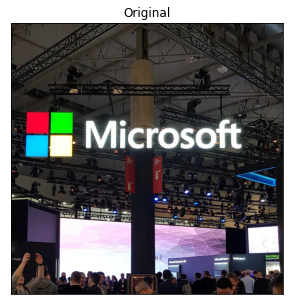

In [6]:
url = 'https://user-images.githubusercontent.com/69428232/149087561-4803b3e0-bcb4-4f9f-a597-c362db24ff9c.jpg'
 
image_nparray = np.asarray(bytearray(requests.get(url).content), dtype=np.uint8)
org_image = cv2.imdecode(image_nparray, cv2.IMREAD_COLOR) 
 
plt_imshow("Original", org_image)

In [7]:
orig = org_image.copy()
(origH, origW) = org_image.shape[:2]
 
(newW, newH) = (width, height)
rW = origW / float(newW)
rH = origH / float(newH)
 
org_image = cv2.resize(org_image, (newW, newH))
(H, W) = org_image.shape[:2]

In [8]:
blob = cv2.dnn.blobFromImage(org_image, 1.0, (W, H), (123.68, 116.78, 103.94), swapRB=True, crop=False)
net.setInput(blob)
(scores, geometry) = net.forward(layerNames)
 
(rects, confidences) = decode_predictions(scores, geometry)
boxes = non_max_suppression(np.array(rects), probs=confidences)

In [31]:
results = []
 
for (startX, startY, endX, endY) in boxes:
    startX = int(startX * rW)
    startY = int(startY * rH)
    endX = int(endX * rW)
    endY = int(endY * rH)
 
    dX = int((endX - startX) * padding)
    dY = int((endY - startY) * padding)
 
    startX = max(0, startX - dX)
    startY = max(0, startY - dY)
    endX = min(origW, endX + (dX * 2))
    endY = min(origH, endY + (dY * 2))
    # 영역 추출
    roi = orig[startY:endY, startX:endX]
    pytesseract.pytesseract.tesseract_cmd = r'C:/Program Files/Tesseract-OCR/tesseract.exe'
    config = ("-l eng --psm 4")
    text = pytesseract.image_to_string(roi, config=config)
 
    results.append(((startX, startY, endX, endY), text))

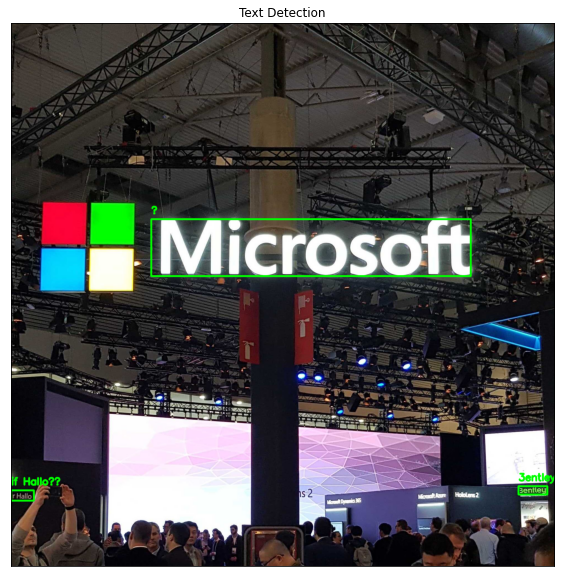

In [32]:
results = sorted(results, key=lambda r:r[0][1])
 
output = orig.copy()
 
# 결과 출력
for ((startX, startY, endX, endY), text) in results:
    cv2.rectangle(output, (startX, startY), (endX, endY), (0, 255, 0), 5)
    cv2.putText(output, text, (startX, startY - 20), cv2.FONT_HERSHEY_SIMPLEX, 1.2, (0, 255, 0), 5)
 
 
plt_imshow("Text Detection", output, figsize=(16, 10))

In [33]:
# This Python file uses the following encoding: utf-8
from PIL import Image
from pytesseract import image_to_string

img = Image.open('./i2t.png')
text = image_to_string(img, lang='kor')
print(text)

1 01 누
1 서 |건
위 (으 몰

6.

>

」



In [34]:
import pytesseract
import cv2
import matplotlib.pyplot as plt

In [114]:
path = './text.jpg'
image = cv2.imread(path)
rgb_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

In [119]:
text = pytesseract.image_to_string(rgb_image, lang='kor+eng')
print(text)

    
  

2017/09/14 =

[Web#!4!]
Pee 여론조사
전문업체
(6월드리서치입니다.
이번에 저희는 서울시와
함께 '정보공개 청구
경험자를 대상'으로 향후 더
나은 정보공개 서비스를
제공하고자 만족도 조사를
실시하고 있습니다. 본
Ate 전화조사로

15일부터 아래 번호로
선생님께 조사 참여를
부탁드리고자 전화를
드릴예정입니다. 많은
부탁드리겠습니다.
※ 통계법 제33조(비밀의
보호)에 의거 선생님의
개인정보 및 설문응답에

 
 
                                                                                                                                                                                                                                                                 
                                                                                                                                                                                                                                                                   
                                                                                                                                                                                                                                   

In [37]:
from imutils.perspective import four_point_transform
import matplotlib.pyplot as plt
import pytesseract
import imutils
import cv2
import re
import requests
import numpy as np

In [54]:
def plt_imshow(title='image', img=None, figsize=(8 ,5)):
    plt.figure(figsize=figsize)
 
    if type(img) == list:
        if type(title) == list:
            titles = title
        else:
            titles = []
 
            for i in range(len(img)):
                titles.append(title)
 
        for i in range(len(img)):
            if len(img[i].shape) <= 2:
                rgbImg = cv2.cvtColor(img[i], cv2.COLOR_GRAY2RGB)
            else:
                rgbImg = cv2.cvtColor(img[i], cv2.COLOR_BGR2RGB)
 
            plt.subplot(1, len(img), i + 1), plt.imshow(rgbImg)
            plt.title(titles[i])
            plt.xticks([]), plt.yticks([])
 
        plt.show()
    else:
        if len(img.shape) < 3:
            rgbImg = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)
        else:
            rgbImg = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
 
        plt.imshow(rgbImg)
        plt.title(title)
        plt.xticks([]), plt.yticks([])
        plt.show()

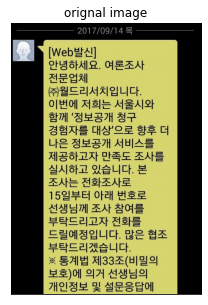

In [206]:
url = 'https://mblogthumb-phinf.pstatic.net/MjAxNzA5MTRfMTI3/MDAxNTA1Mzk0MjQ5MDkw.2gVXozYu5tAAyBgWQGtuXO4pUTUsaab_dK9Y26fd1-Yg.YvEwQ0_5FDDKwJIUS16xyNz0JB7IFo5rHlszDaR-NiMg.JPEG.kangyu718/Screenshot_2017-09-14-20-20-47.png?type=w800'
# url = 'https://user-images.githubusercontent.com/69428232/148330274-237d9b23-4a79-4416-8ef1-bb7b2b52edc4.jpg'


image_nparray = np.asarray(bytearray(requests.get(url).content), dtype=np.uint8)
org_image = cv2.imdecode(image_nparray, cv2.IMREAD_COLOR) 
 
plt_imshow("orignal image", org_image)

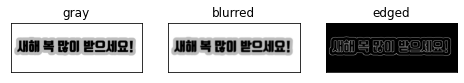

In [177]:
image = org_image.copy()
image = imutils.resize(image, width=500)
ratio = org_image.shape[1] / float(image.shape[1])
 
# 이미지를 grayscale로 변환하고 blur를 적용
# 모서리를 찾기위한 이미지 연산
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
blurred = cv2.GaussianBlur(gray, (5, 5,), 0)
edged = cv2.Canny(blurred, 75, 200)
 
plt_imshow(['gray', 'blurred', 'edged'], [gray, blurred, edged])

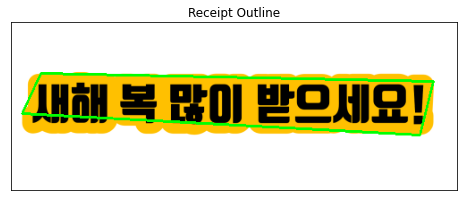

In [178]:
# contours를 찾아 크기순으로 정렬
cnts = cv2.findContours(edged.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

cnts = imutils.grab_contours(cnts)
cnts = sorted(cnts, key=cv2.contourArea, reverse=True)

 
receiptCnt = None
 
# 정렬된 contours를 반복문으로 수행하며 4개의 꼭지점을 갖는 도형을 검출
for c in cnts:
	peri = cv2.arcLength(c, True)
	approx = cv2.approxPolyDP(c, 0.02 * peri, True)
 
	# contours가 크기순으로 정렬되어 있기때문에 제일 첫번째 사각형을 영수증 영역으로 판단하고 break
	if len(approx) == 4:
		receiptCnt = approx
		break
 
 
# 만약 추출한 윤곽이 없을 경우 오류
if receiptCnt is None:
	raise Exception(("Could not find receipt outline."))
    
output = image.copy()
cv2.drawContours(output, [receiptCnt], -1, (0, 255, 0), 2)
plt_imshow("Receipt Outline", output)

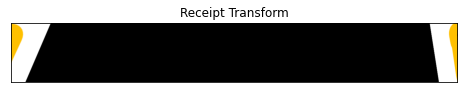

In [179]:
# 원본 이미지에 찾은 윤곽을 기준으로 이미지를 보정
receipt = four_point_transform(org_image, receiptCnt.reshape(4, 2) * ratio)
plt_imshow("Receipt Transform", receipt)

In [167]:
options = "--psm 4"
text = pytesseract.image_to_string(cv2.cvtColor(receipt, cv2.COLOR_BGR2RGB), config=options)
 
# OCR결과 출력
print("[INFO] OCR결과:")
print("==================")
print(text)
print("\n")

[INFO] OCR결과:





In [181]:
def run_tesseract_ocr(image, width, ksize=(5,5), min_threshold=75, max_threshold=200, lang='eng'):
    image_list_title = []
    image_list = []

    image = imutils.resize(image, width=width)
    ratio = org_image.shape[1] / float(image.shape[1])

    # 이미지를 grayscale로 변환하고 blur를 적용
    # 모서리를 찾기위한 이미지 연산
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, ksize, 0)
    edged = cv2.Canny(blurred, min_threshold, max_threshold)

    image_list_title = ['gray', 'blurred', 'edged']
    image_list = [gray, blurred, edged]

    # contours를 찾아 크기순으로 정렬
    cnts = cv2.findContours(edged.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    cnts = sorted(cnts, key=cv2.contourArea, reverse=True)

    receiptCnt = None

    # 정렬된 contours를 반복문으로 수행하며 4개의 꼭지점을 갖는 도형을 검출
    for c in cnts:
        peri = cv2.arcLength(c, True)
        approx = cv2.approxPolyDP(c, 0.02 * peri, True)
 
    # contours가 크기순으로 정렬되어 있기때문에 제일 첫번째 사각형을 영수증 영역으로 판단하고 break
        if len(approx) == 4:
            receiptCnt = approx
            break
 
 
  # 만약 추출한 윤곽이 없을 경우 오류
    if receiptCnt is None:
        raise Exception(("Could not find receipt outline."))
 
 
    output = image.copy()
    cv2.drawContours(output, [receiptCnt], -1, (0, 255, 0), 2)

    image_list_title.append("Receipt Outline")
    image_list.append(output)

    # 원본 이미지에 찾은 윤곽을 기준으로 이미지를 보정
    receipt = four_point_transform(org_image, receiptCnt.reshape(4, 2) * ratio)

    plt_imshow(image_list_title, image_list)
    plt_imshow("Receipt Transform", receipt)

    options = "--psm 4"

    text = pytesseract.image_to_string(cv2.cvtColor(receipt, cv2.COLOR_BGR2RGB), lang=lang, config=options)

    # OCR결과 출력
    print("[INFO] OCR결과:")
    print("==================")
    print(text)

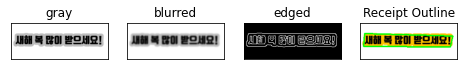

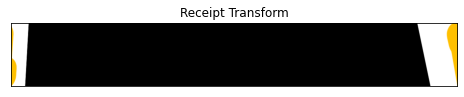

[INFO] OCR결과:



In [182]:
url = 'https://cdn.imweb.me/upload/S201911194483dd7a28d0d/ea7d24ddebffb.png'
# url = 'https://user-images.githubusercontent.com/69428232/155486780-55525c3c-8f5f-4313-8590-dd69d4ce4111.jpg'

 
image_nparray = np.asarray(bytearray(requests.get(url).content), dtype=np.uint8)
org_image = cv2.imdecode(image_nparray, cv2.IMREAD_COLOR) 
 
run_tesseract_ocr(org_image, width=200, ksize=(5, 5), min_threshold=20, max_threshold=100, lang='kor+eng')

In [62]:
from imutils.perspective import four_point_transform
from imutils.contours import sort_contours
import matplotlib.pyplot as plt
import pytesseract
import imutils
import cv2
import re
import requests
import numpy as np

In [63]:
def plt_imshow(title='image', img=None, figsize=(8 ,5)):
    plt.figure(figsize=figsize)
 
    if type(img) == list:
        if type(title) == list:
            titles = title
        else:
            titles = []
 
            for i in range(len(img)):
                titles.append(title)
 
        for i in range(len(img)):
            if len(img[i].shape) <= 2:
                rgbImg = cv2.cvtColor(img[i], cv2.COLOR_GRAY2RGB)
            else:
                rgbImg = cv2.cvtColor(img[i], cv2.COLOR_BGR2RGB)
 
            plt.subplot(1, len(img), i + 1), plt.imshow(rgbImg)
            plt.title(titles[i])
            plt.xticks([]), plt.yticks([])
 
        plt.show()
    else:
        if len(img.shape) < 3:
            rgbImg = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)
        else:
            rgbImg = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
 
        plt.imshow(rgbImg)
        plt.title(title)
        plt.xticks([]), plt.yticks([])
        plt.show()

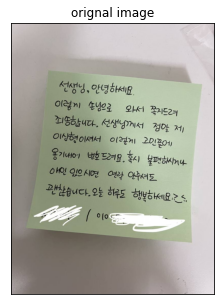

In [188]:
url = 'http://file3.instiz.net/data/cached_img/upload/2022/07/20/0/b5b7db489ed9e16f738b732adfaa2975.jpg'
 
image_nparray = np.asarray(bytearray(requests.get(url).content), dtype=np.uint8)
org_image = cv2.imdecode(image_nparray, cv2.IMREAD_COLOR) 
 
plt_imshow("orignal image", org_image)

In [189]:
def make_scan_image(image, width, ksize=(5,5), min_threshold=75, max_threshold=200):
    image_list_title = []
    image_list = []
 
    org_image = image.copy()
    image = imutils.resize(image, width=width)
    ratio = org_image.shape[1] / float(image.shape[1])

    # 이미지를 grayscale로 변환하고 blur를 적용
    # 모서리를 찾기위한 이미지 연산
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, ksize, 0)
    edged = cv2.Canny(blurred, min_threshold, max_threshold)

    image_list_title = ['gray', 'blurred', 'edged']
    image_list = [gray, blurred, edged]

    # contours를 찾아 크기순으로 정렬
    cnts = cv2.findContours(edged.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    cnts = sorted(cnts, key=cv2.contourArea, reverse=True)

    findCnt = None

  # 정렬된 contours를 반복문으로 수행하며 4개의 꼭지점을 갖는 도형을 검출
    for c in cnts:
        peri = cv2.arcLength(c, True)
        approx = cv2.approxPolyDP(c, 0.02 * peri, True)
 
    # contours가 크기순으로 정렬되어 있기때문에 제일 첫번째 사각형을 영역으로 판단하고 break
        if len(approx) == 4:
            findCnt = approx
            break
 
  # 만약 추출한 윤곽이 없을 경우 오류
    if findCnt is None:
        raise Exception(("Could not find outline."))
 
    output = image.copy()
    cv2.drawContours(output, [findCnt], -1, (0, 255, 0), 2)

    image_list_title.append("Outline")
    image_list.append(output)

    # 원본 이미지에 찾은 윤곽을 기준으로 이미지를 보정
    transform_image = four_point_transform(org_image, findCnt.reshape(4, 2) * ratio)

    plt_imshow(image_list_title, image_list)
    plt_imshow("Transform", transform_image)

    return transform_image

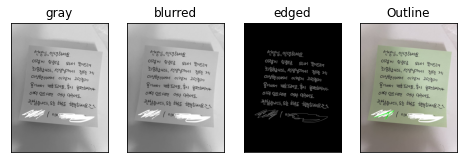

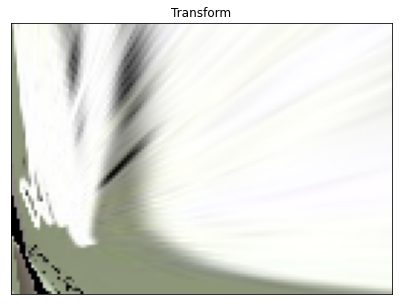

In [205]:
receipt_image = make_scan_image(org_image, width=800, ksize=(5, 5), min_threshold=10, max_threshold=250)

In [186]:
options = "--psm 4"
text = pytesseract.image_to_string(cv2.cvtColor(receipt, cv2.COLOR_BGR2RGB), config=options)
 
# OCR결과 출력
print("[INFO] OCR결과:")
print("==================")
print(text)
print("\n")

[INFO] OCR결과:





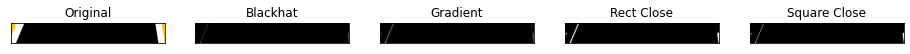

In [187]:
gray = cv2.cvtColor(receipt, cv2.COLOR_BGR2GRAY)
(H, W) = gray.shape
 
rectKernel = cv2.getStructuringElement(cv2.MORPH_RECT, (30, 20))
sqKernel = cv2.getStructuringElement(cv2.MORPH_RECT, (50, 21))
 
gray = cv2.GaussianBlur(gray, (11, 11), 0)
blackhat = cv2.morphologyEx(gray, cv2.MORPH_BLACKHAT, rectKernel)
 
grad = cv2.Sobel(blackhat, ddepth=cv2.CV_32F, dx=1, dy=0, ksize=-1)
grad = np.absolute(grad)
(minVal, maxVal) = (np.min(grad), np.max(grad))
grad = (grad - minVal) / (maxVal - minVal)
grad = (grad * 255).astype("uint8")
 
grad = cv2.morphologyEx(grad, cv2.MORPH_CLOSE, rectKernel)
thresh = cv2.threshold(grad, 0, 255, cv2.THRESH_BINARY | cv2.THRESH_OTSU)[1]
 
close_thresh = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, sqKernel)
close_thresh = cv2.erode(close_thresh, None, iterations=2)
 
plt_imshow(["Original", "Blackhat", "Gradient", "Rect Close", "Square Close"], [receipt, blackhat, grad, thresh, close_thresh], figsize=(16, 10))

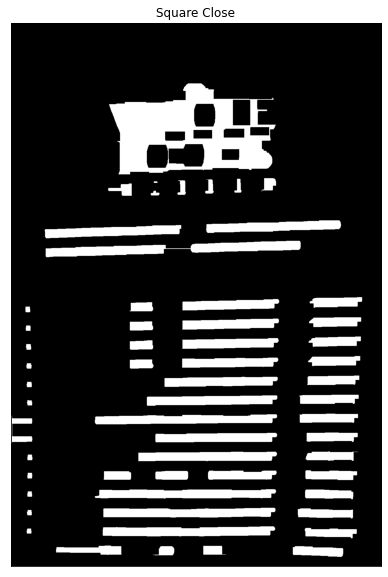

In [86]:
plt_imshow(["Square Close"], [close_thresh], figsize=(16, 10))

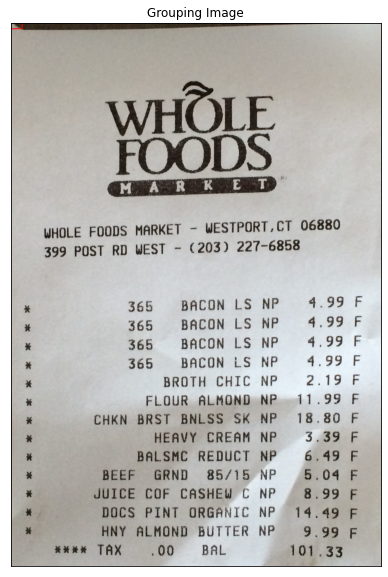

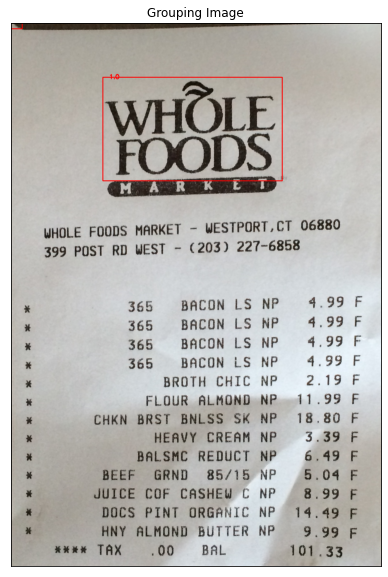

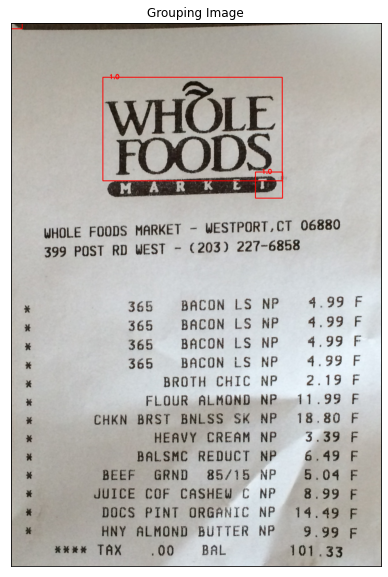

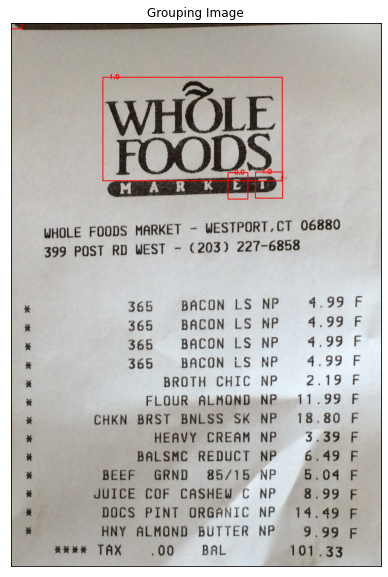

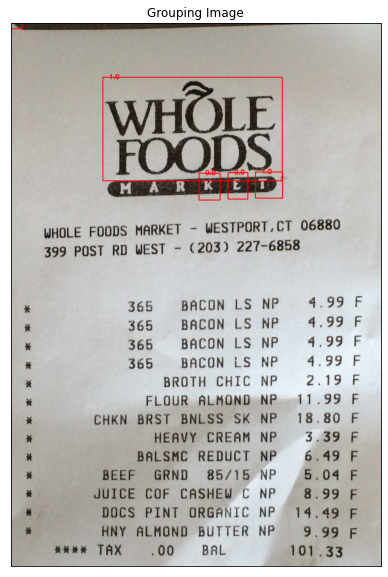

...

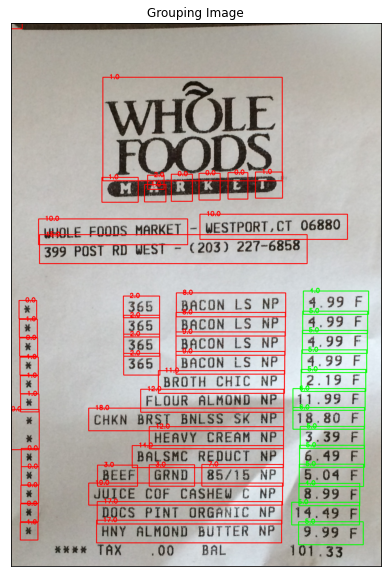

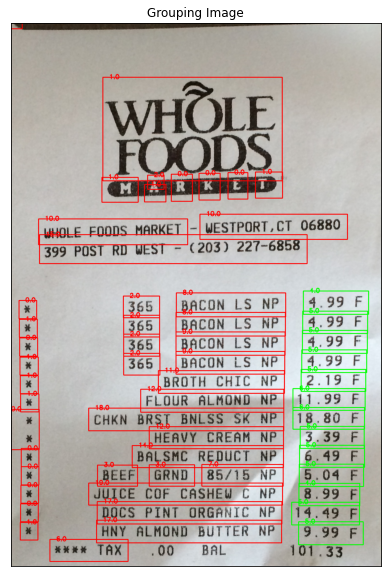

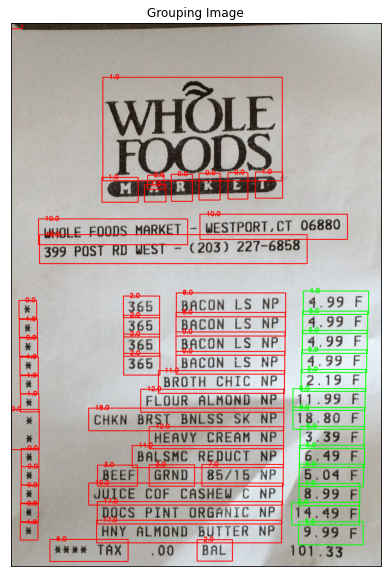

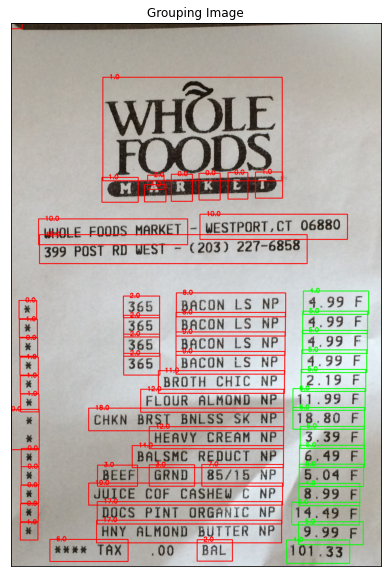

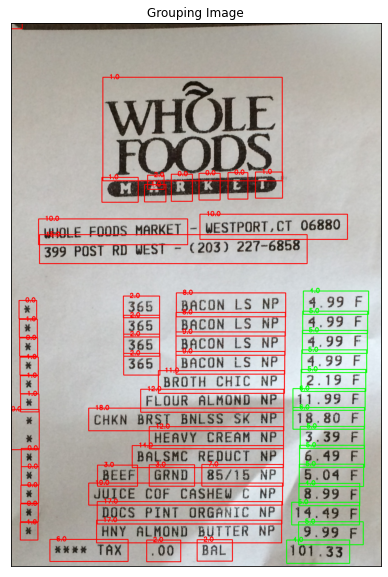

In [87]:
cnts = cv2.findContours(close_thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(cnts)
cnts = sort_contours(cnts, method="top-to-bottom")[0]
 
roi_list = []
roi_title_list = []
 
margin = 20
receipt_grouping = receipt.copy()
 
for c in cnts:
    (x, y, w, h) = cv2.boundingRect(c)
    ar = w // float(h)
 
    if ar > 3.0 and ar < 6.5 and (W/2) < x:
        color = (0, 255, 0)
        roi = receipt[y - margin:y + h + margin, x - margin:x + w + margin]
        roi_list.append(roi)
        roi_title_list.append("Roi_{}".format(len(roi_list)))
    else:
        color = (0, 0, 255)
 
    cv2.rectangle(receipt_grouping, (x - margin, y - margin), (x + w + margin, y + h + margin), color, 2)
    cv2.putText(receipt_grouping, "".join(str(ar)), (x, y - 15), cv2.FONT_HERSHEY_SIMPLEX, 0.65, color, 2)

    plt_imshow(["Grouping Image"], [receipt_grouping], figsize=(16, 10))

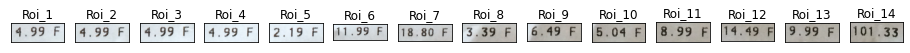

4.99 F

4.99 F

4.99 F

4.99 F

2.19 F

11.99 F

18.80 F

3.39 F

6.49 F

5.04 F

8.99 F

14.49 F

9.99 F

101.33



In [88]:
plt_imshow(roi_title_list, roi_list, figsize=(16, 10))
 
for roi in roi_list:
    gray_roi= cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
    threshold_roi = cv2.threshold(gray_roi, 0, 255, cv2.THRESH_BINARY | cv2.THRESH_OTSU)[1]
    roi_text = pytesseract.image_to_string(threshold_roi)
    print(roi_text)

In [89]:
def mergeResize(img, row=300, col=200):
    IMG_COL = col #66
 
    # row값에 따른 col값 변경
    IMG_COL = int((row * IMG_COL)/row)
 
    IMG_ROW = row
    border_v = 0
    border_h = 0
 
    if (IMG_COL / IMG_ROW) >= (img.shape[0] / img.shape[1]):
        border_v = int((((IMG_COL / IMG_ROW) * img.shape[1]) - img.shape[0]) / 2)
    else:
        border_h = int((((IMG_ROW / IMG_COL) * img.shape[0]) - img.shape[1]) / 2)
    img = cv2.copyMakeBorder(img, top=border_v, bottom=border_v, left=0, right=border_h + border_h, borderType=cv2.BORDER_CONSTANT, value=(255, 255, 255))
    img = cv2.resize(img, (IMG_ROW, IMG_COL))
    return img

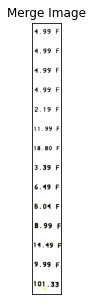

4.99 F
4.99 F
4.99 F
4.99 F
2.19 F
11.99 F
18.80 F
3.39 F
6.49 F
5.04 F
8.99 F
14.49 F
9.99 F

101.33



In [90]:
for idx, roi in enumerate(roi_list):
    if idx == 0:
        mergeImg = mergeResize(roi)
    else:
        cropImg = mergeResize(roi)
        mergeImg = np.concatenate((mergeImg, cropImg), axis=0)
    
threshold_mergeImg = cv2.threshold(mergeImg, 150, 255, cv2.THRESH_BINARY)[1]
plt_imshow(["Merge Image"], [threshold_mergeImg])
merge_Img_text = pytesseract.image_to_string(threshold_mergeImg)
print(merge_Img_text)

In [91]:
phoneNums = re.findall(r'[\+\(]?[1-9][0-9 .\-\(\)]{8,}[0-9]', text)
phoneNums

['(203) 227-6858']

In [92]:
prices = re.findall(r"(?:NP )([0-9\.\-+_]+\.[0-9\.\-+_]+)", text)
prices

['4.99',
 '4.99',
 '4.99',
 '4.15',
 '11.99',
 '18.80',
 '3.39',
 '6.49',
 '5.04',
 '8.99',
 '14.49',
 '9.99']

In [93]:
total_price = re.findall(r"(?:BAL )([0-9\.\-+_]+\.[0-9\.\-+_]+)", text)
total_price

['101.33']

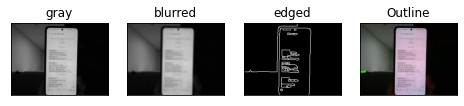

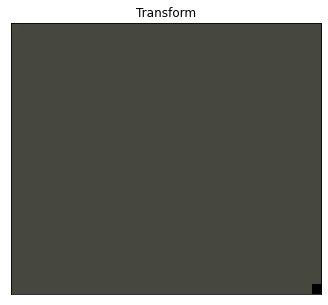

In [97]:
url = 'https://user-images.githubusercontent.com/69428232/155486780-55525c3c-8f5f-4313-8590-dd69d4ce4111.jpg'
 
image_nparray = np.asarray(bytearray(requests.get(url).content), dtype=np.uint8)
org_image = cv2.imdecode(image_nparray, cv2.IMREAD_COLOR) 
 
business_card_image = make_scan_image(org_image, width=200, ksize=(5, 5), min_threshold=20, max_threshold=100)

In [95]:
options = "--psm 4"
text = pytesseract.image_to_string(business_card_image, config=options, lang='kor+eng')
 
# OCR결과 출력
print("[INFO] OCR결과:")
print("==================")
print(text)
print("\n")

[INFO] OCR결과:
oS  So
김 윤 웅
수석
T Biz. Digital | C&C

SK 2413)4t

13486, 경기도 성남시 분당구 판교로 255번길 38
< 주식회사 판교캠퍼스

Tel
Mobile

www.sk.co.kr



